In [1]:
import os
import json
import math
import numpy as np 
import pandas as pd
import csv
import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.data import random_split
import torch.nn.functional as F
import matplotlib.pyplot as plt
from PIL import Image

## Imports for plotting
import matplotlib.pyplot as plt
%matplotlib inline 
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('svg', 'pdf') # For export
from matplotlib.colors import to_rgb
import matplotlib
matplotlib.rcParams['lines.linewidth'] = 2.0
import seaborn as sns
sns.reset_orig()
sns.set()

C:\Users\wojte\AppData\Local\Temp\ipykernel_13212\1259733285.py:21: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  set_matplotlib_formats('svg', 'pdf') # For export


In [2]:
batch_size=32

In [3]:
torch.cuda.set_device(0)
device = torch.device("cuda")

In [4]:
transform = transforms.Compose([transforms.ToTensor()])

dataset = torchvision.datasets.ImageFolder("./trafic_32/trafic_32/", transform=transform)

trainloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2)


In [5]:
print(dataset[2][0].shape)

torch.Size([3, 32, 32])


In [6]:
print(len(dataset))

39209


<Figure size 2000x1000 with 0 Axes>

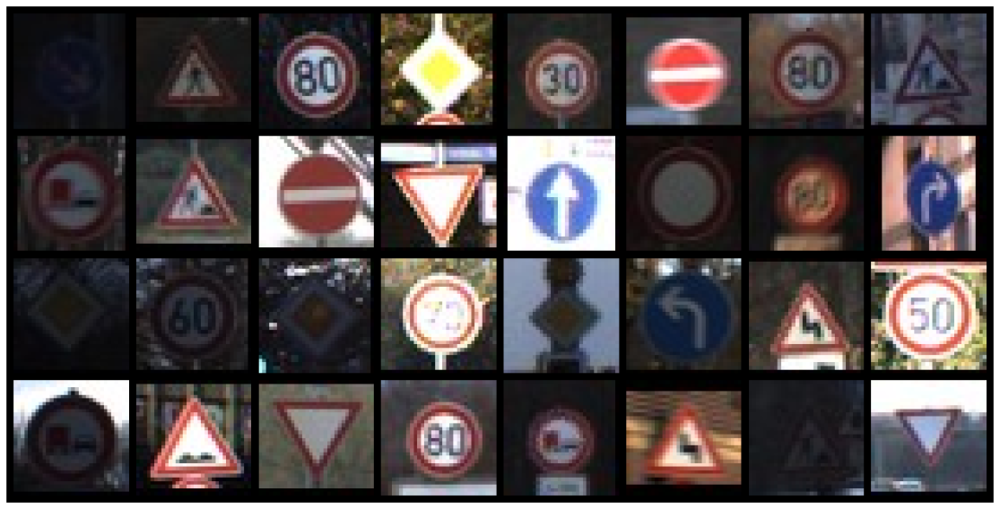

In [13]:
plt.figure(figsize = (20,10))  # get some random training images dataiter = iter(trainloader) images, labels = next(dataiter)  def imshow(img):     img = img / 2 + 0.5     # unnormalize     npimg = img.numpy()     plt.imshow(np.transpose(npimg, (1, 2, 0)))     plt.show() # get some random training images dataiter = iter(trainloader) images, labels = next(dataiter)  # show images imshow(torchvision.utils.make_grid(images))  print(' '.join('%5s' % classes[labels[j]] for j in range(batch_size)))
plt.figure(figsize = (20,10))

def imshow(img):
    npimg = img.numpy()
    plt.axis('off')
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()
    
# get some random training images
dataiter = iter(trainloader)
images, labels = next(dataiter)

# show images
imshow(torchvision.utils.make_grid(images))

In [14]:
class Discriminator(nn.Module):
    def __init__(self, input_dim, hidden_dim):
        super(Discriminator, self).__init__()

        self.fc_1 = nn.Linear(input_dim, hidden_dim)
        self.fc_2 = nn.Linear(hidden_dim, hidden_dim)
        self.fc_out  = nn.Linear(hidden_dim, 1)
        
        self.LeakyReLU = nn.LeakyReLU(0.2)

    def forward(self, x):
        x = torch.flatten(x, 1)
        x = self.LeakyReLU(self.fc_1(x))
        x = self.LeakyReLU(self.fc_2(x))
        x = self.fc_out(x)
        return x

In [15]:
class Generator(nn.Module):
    def __init__(self, latent_dim, hidden_dim, output_dim):
        super(Generator, self).__init__()
        self.fc_1 = nn.Linear(latent_dim, hidden_dim)
        self.fc_2 = nn.Linear(hidden_dim, hidden_dim)
        self.fc_3 = nn.Linear(hidden_dim, output_dim)
        
        self.LeakyReLU = nn.LeakyReLU(0.2)
        
    def forward(self, x):
        h     = self.LeakyReLU(self.fc_1(x))
        h     = self.LeakyReLU(self.fc_2(h))
        
        x_hat = torch.sigmoid(self.fc_3(h))
        x_hat = x_hat.view([-1, 3, 32, 32])
        return x_hat

In [16]:
# Models
latent_dim = 64
generator = Generator(latent_dim=latent_dim, hidden_dim=256, output_dim=3072).to(device)
discriminator = Discriminator(hidden_dim=256, input_dim=3072).to(device)

# Optimizers
generator_optimizer = torch.optim.Adam(generator.parameters(), lr=0.0001)
generator_scheduler = optim.lr_scheduler.ExponentialLR(optimizer=generator_optimizer, gamma=0.99)
discriminator_optimizer = torch.optim.Adam(discriminator.parameters(), lr=0.0001)
discriminator_scheduler = optim.lr_scheduler.ExponentialLR(optimizer=discriminator_optimizer, gamma=0.99)

# loss
criterion = nn.MSELoss()

In [17]:
fixed_noise = torch.randn(batch_size, latent_dim, device=device)

<h1>TRAINING</h1>

Epoch: 0, discriminator fake error: 0.0785, discriminator real acc: 0.827


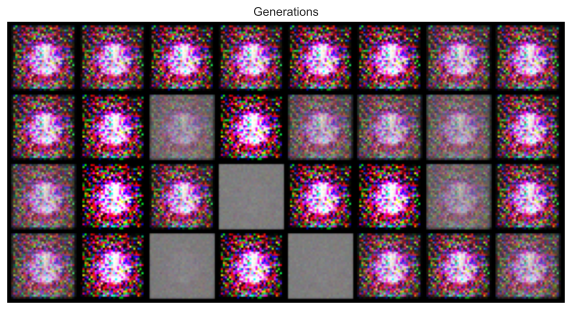

Epoch: 1, discriminator fake error: 0.0653, discriminator real acc: 0.921
Epoch: 2, discriminator fake error: 0.0911, discriminator real acc: 0.905
Epoch: 3, discriminator fake error: 0.0908, discriminator real acc: 0.909
Epoch: 4, discriminator fake error: 0.126, discriminator real acc: 0.883
Epoch: 5, discriminator fake error: 0.163, discriminator real acc: 0.843
Epoch: 6, discriminator fake error: 0.176, discriminator real acc: 0.831
Epoch: 7, discriminator fake error: 0.175, discriminator real acc: 0.831
Epoch: 8, discriminator fake error: 0.155, discriminator real acc: 0.85
Epoch: 9, discriminator fake error: 0.178, discriminator real acc: 0.826
Epoch: 10, discriminator fake error: 0.194, discriminator real acc: 0.81


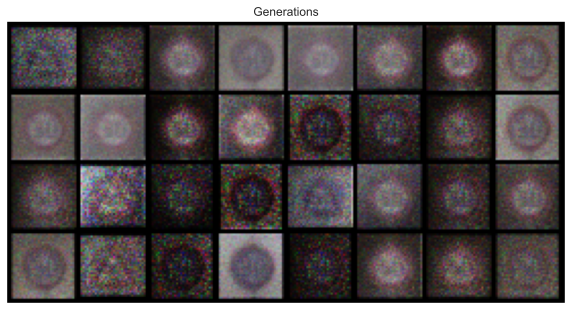

Epoch: 11, discriminator fake error: 0.184, discriminator real acc: 0.819
Epoch: 12, discriminator fake error: 0.171, discriminator real acc: 0.836
Epoch: 13, discriminator fake error: 0.183, discriminator real acc: 0.826
Epoch: 14, discriminator fake error: 0.187, discriminator real acc: 0.821
Epoch: 15, discriminator fake error: 0.192, discriminator real acc: 0.816
Epoch: 16, discriminator fake error: 0.186, discriminator real acc: 0.815
Epoch: 17, discriminator fake error: 0.185, discriminator real acc: 0.813
Epoch: 18, discriminator fake error: 0.206, discriminator real acc: 0.79
Epoch: 19, discriminator fake error: 0.212, discriminator real acc: 0.79
Epoch: 20, discriminator fake error: 0.215, discriminator real acc: 0.783


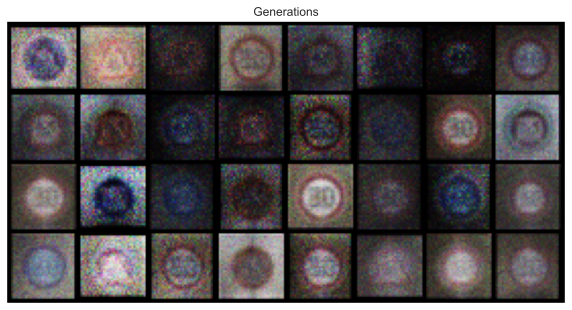

Epoch: 21, discriminator fake error: 0.227, discriminator real acc: 0.773
Epoch: 22, discriminator fake error: 0.226, discriminator real acc: 0.771
Epoch: 23, discriminator fake error: 0.223, discriminator real acc: 0.777
Epoch: 24, discriminator fake error: 0.222, discriminator real acc: 0.779
Epoch: 25, discriminator fake error: 0.212, discriminator real acc: 0.786
Epoch: 26, discriminator fake error: 0.217, discriminator real acc: 0.783
Epoch: 27, discriminator fake error: 0.223, discriminator real acc: 0.778
Epoch: 28, discriminator fake error: 0.221, discriminator real acc: 0.78
Epoch: 29, discriminator fake error: 0.226, discriminator real acc: 0.773
Epoch: 30, discriminator fake error: 0.216, discriminator real acc: 0.784


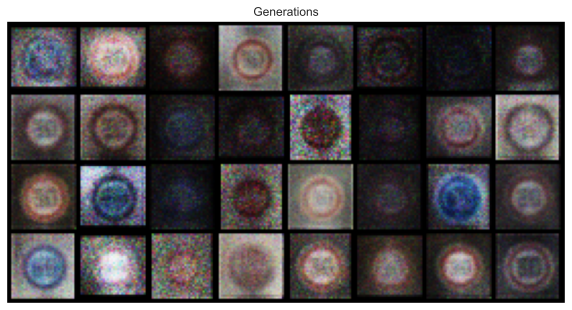

Epoch: 31, discriminator fake error: 0.229, discriminator real acc: 0.768
Epoch: 32, discriminator fake error: 0.228, discriminator real acc: 0.772
Epoch: 33, discriminator fake error: 0.23, discriminator real acc: 0.768
Epoch: 34, discriminator fake error: 0.23, discriminator real acc: 0.77
Epoch: 35, discriminator fake error: 0.235, discriminator real acc: 0.763
Epoch: 36, discriminator fake error: 0.235, discriminator real acc: 0.767
Epoch: 37, discriminator fake error: 0.237, discriminator real acc: 0.762
Epoch: 38, discriminator fake error: 0.243, discriminator real acc: 0.758
Epoch: 39, discriminator fake error: 0.247, discriminator real acc: 0.753
Epoch: 40, discriminator fake error: 0.242, discriminator real acc: 0.755


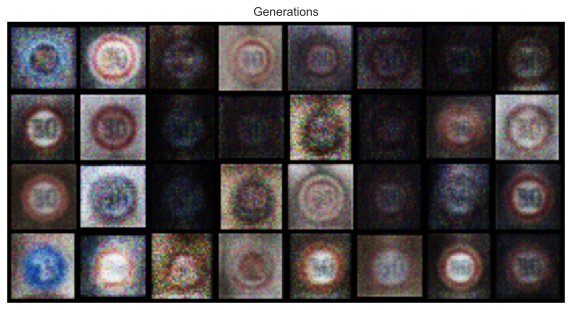

Epoch: 41, discriminator fake error: 0.246, discriminator real acc: 0.753
Epoch: 42, discriminator fake error: 0.251, discriminator real acc: 0.747
Epoch: 43, discriminator fake error: 0.264, discriminator real acc: 0.736
Epoch: 44, discriminator fake error: 0.271, discriminator real acc: 0.732
Epoch: 45, discriminator fake error: 0.266, discriminator real acc: 0.734
Epoch: 46, discriminator fake error: 0.278, discriminator real acc: 0.725
Epoch: 47, discriminator fake error: 0.274, discriminator real acc: 0.725
Epoch: 48, discriminator fake error: 0.277, discriminator real acc: 0.724
Epoch: 49, discriminator fake error: 0.276, discriminator real acc: 0.726
Epoch: 50, discriminator fake error: 0.274, discriminator real acc: 0.727


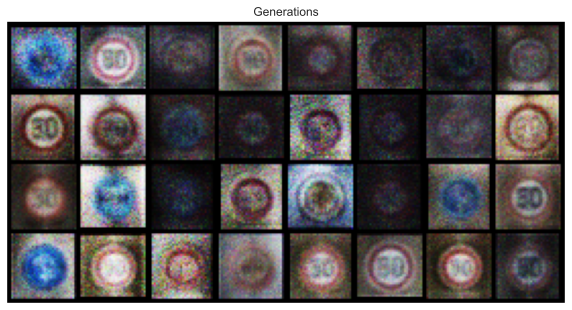

Epoch: 51, discriminator fake error: 0.279, discriminator real acc: 0.725
Epoch: 52, discriminator fake error: 0.274, discriminator real acc: 0.729
Epoch: 53, discriminator fake error: 0.276, discriminator real acc: 0.725
Epoch: 54, discriminator fake error: 0.278, discriminator real acc: 0.724
Epoch: 55, discriminator fake error: 0.283, discriminator real acc: 0.717
Epoch: 56, discriminator fake error: 0.275, discriminator real acc: 0.721
Epoch: 57, discriminator fake error: 0.267, discriminator real acc: 0.732
Epoch: 58, discriminator fake error: 0.272, discriminator real acc: 0.729
Epoch: 59, discriminator fake error: 0.265, discriminator real acc: 0.733
Epoch: 60, discriminator fake error: 0.277, discriminator real acc: 0.723


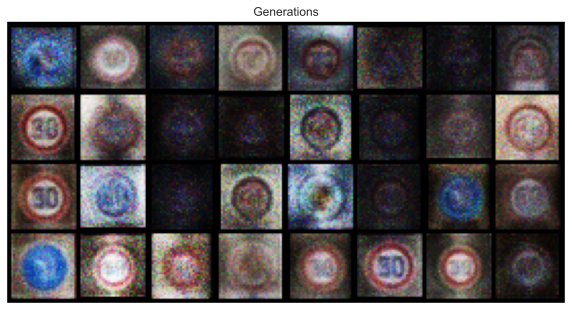

Epoch: 61, discriminator fake error: 0.273, discriminator real acc: 0.724
Epoch: 62, discriminator fake error: 0.278, discriminator real acc: 0.721
Epoch: 63, discriminator fake error: 0.277, discriminator real acc: 0.721
Epoch: 64, discriminator fake error: 0.287, discriminator real acc: 0.712
Epoch: 65, discriminator fake error: 0.286, discriminator real acc: 0.713
Epoch: 66, discriminator fake error: 0.294, discriminator real acc: 0.706
Epoch: 67, discriminator fake error: 0.301, discriminator real acc: 0.699
Epoch: 68, discriminator fake error: 0.295, discriminator real acc: 0.708
Epoch: 69, discriminator fake error: 0.305, discriminator real acc: 0.694
Epoch: 70, discriminator fake error: 0.303, discriminator real acc: 0.696


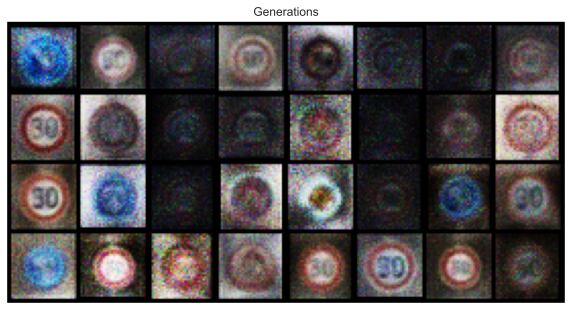

Epoch: 71, discriminator fake error: 0.305, discriminator real acc: 0.696
Epoch: 72, discriminator fake error: 0.304, discriminator real acc: 0.698
Epoch: 73, discriminator fake error: 0.312, discriminator real acc: 0.691
Epoch: 74, discriminator fake error: 0.304, discriminator real acc: 0.697
Epoch: 75, discriminator fake error: 0.308, discriminator real acc: 0.693
Epoch: 76, discriminator fake error: 0.311, discriminator real acc: 0.688
Epoch: 77, discriminator fake error: 0.312, discriminator real acc: 0.69
Epoch: 78, discriminator fake error: 0.316, discriminator real acc: 0.685
Epoch: 79, discriminator fake error: 0.307, discriminator real acc: 0.694
Epoch: 80, discriminator fake error: 0.315, discriminator real acc: 0.688


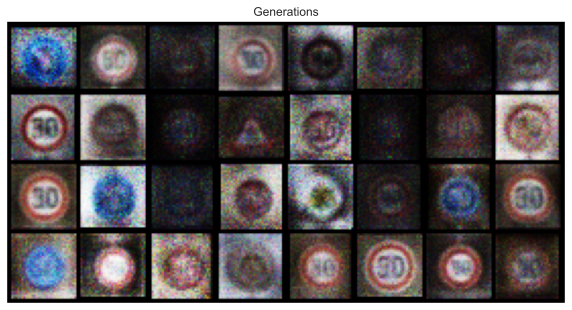

Epoch: 81, discriminator fake error: 0.308, discriminator real acc: 0.691
Epoch: 82, discriminator fake error: 0.308, discriminator real acc: 0.691
Epoch: 83, discriminator fake error: 0.313, discriminator real acc: 0.691
Epoch: 84, discriminator fake error: 0.307, discriminator real acc: 0.695
Epoch: 85, discriminator fake error: 0.312, discriminator real acc: 0.685
Epoch: 86, discriminator fake error: 0.313, discriminator real acc: 0.687
Epoch: 87, discriminator fake error: 0.308, discriminator real acc: 0.694
Epoch: 88, discriminator fake error: 0.317, discriminator real acc: 0.684
Epoch: 89, discriminator fake error: 0.312, discriminator real acc: 0.689
Epoch: 90, discriminator fake error: 0.313, discriminator real acc: 0.689


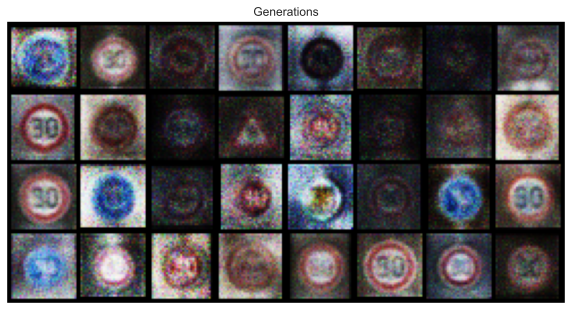

Epoch: 91, discriminator fake error: 0.315, discriminator real acc: 0.688
Epoch: 92, discriminator fake error: 0.314, discriminator real acc: 0.687
Epoch: 93, discriminator fake error: 0.32, discriminator real acc: 0.681
Epoch: 94, discriminator fake error: 0.318, discriminator real acc: 0.683
Epoch: 95, discriminator fake error: 0.312, discriminator real acc: 0.692
Epoch: 96, discriminator fake error: 0.309, discriminator real acc: 0.694
Epoch: 97, discriminator fake error: 0.32, discriminator real acc: 0.683
Epoch: 98, discriminator fake error: 0.309, discriminator real acc: 0.696
Epoch: 99, discriminator fake error: 0.304, discriminator real acc: 0.7
Epoch: 100, discriminator fake error: 0.306, discriminator real acc: 0.693


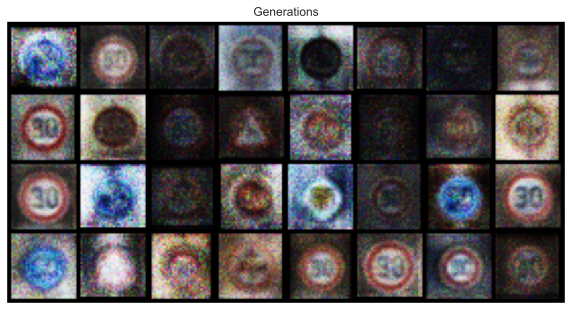

Epoch: 101, discriminator fake error: 0.306, discriminator real acc: 0.691
Epoch: 102, discriminator fake error: 0.302, discriminator real acc: 0.7
Epoch: 103, discriminator fake error: 0.308, discriminator real acc: 0.695
Epoch: 104, discriminator fake error: 0.31, discriminator real acc: 0.693
Epoch: 105, discriminator fake error: 0.309, discriminator real acc: 0.694
Epoch: 106, discriminator fake error: 0.31, discriminator real acc: 0.69
Epoch: 107, discriminator fake error: 0.316, discriminator real acc: 0.683
Epoch: 108, discriminator fake error: 0.312, discriminator real acc: 0.693
Epoch: 109, discriminator fake error: 0.307, discriminator real acc: 0.695
Epoch: 110, discriminator fake error: 0.309, discriminator real acc: 0.689


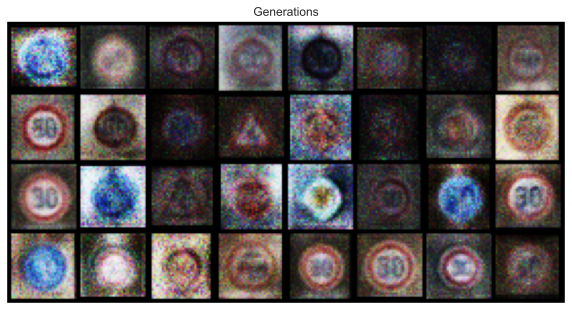

Epoch: 111, discriminator fake error: 0.311, discriminator real acc: 0.689
Epoch: 112, discriminator fake error: 0.311, discriminator real acc: 0.689
Epoch: 113, discriminator fake error: 0.309, discriminator real acc: 0.693
Epoch: 114, discriminator fake error: 0.315, discriminator real acc: 0.688
Epoch: 115, discriminator fake error: 0.313, discriminator real acc: 0.687
Epoch: 116, discriminator fake error: 0.313, discriminator real acc: 0.688
Epoch: 117, discriminator fake error: 0.312, discriminator real acc: 0.689
Epoch: 118, discriminator fake error: 0.31, discriminator real acc: 0.691
Epoch: 119, discriminator fake error: 0.312, discriminator real acc: 0.691
Epoch: 120, discriminator fake error: 0.315, discriminator real acc: 0.686


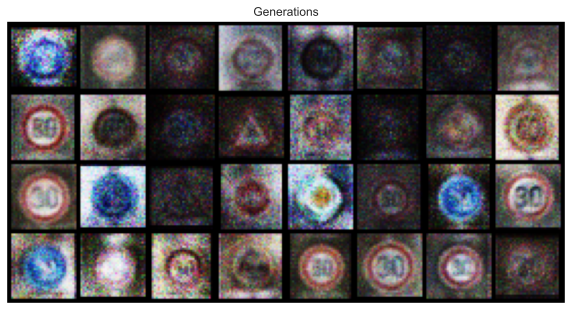

Epoch: 121, discriminator fake error: 0.315, discriminator real acc: 0.686
Epoch: 122, discriminator fake error: 0.315, discriminator real acc: 0.687
Epoch: 123, discriminator fake error: 0.31, discriminator real acc: 0.691
Epoch: 124, discriminator fake error: 0.31, discriminator real acc: 0.692
Epoch: 125, discriminator fake error: 0.312, discriminator real acc: 0.687
Epoch: 126, discriminator fake error: 0.314, discriminator real acc: 0.688
Epoch: 127, discriminator fake error: 0.316, discriminator real acc: 0.687
Epoch: 128, discriminator fake error: 0.315, discriminator real acc: 0.689
Epoch: 129, discriminator fake error: 0.311, discriminator real acc: 0.69
Epoch: 130, discriminator fake error: 0.318, discriminator real acc: 0.682


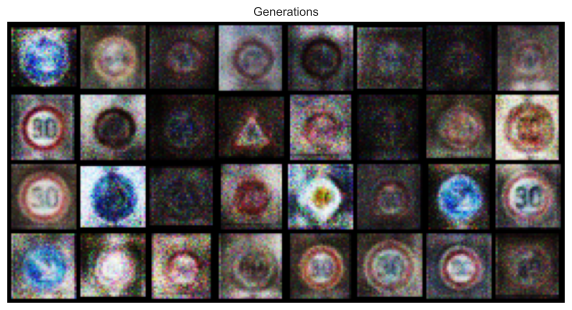

Epoch: 131, discriminator fake error: 0.311, discriminator real acc: 0.69
Epoch: 132, discriminator fake error: 0.318, discriminator real acc: 0.682
Epoch: 133, discriminator fake error: 0.308, discriminator real acc: 0.697
Epoch: 134, discriminator fake error: 0.316, discriminator real acc: 0.686
Epoch: 135, discriminator fake error: 0.319, discriminator real acc: 0.682
Epoch: 136, discriminator fake error: 0.319, discriminator real acc: 0.684
Epoch: 137, discriminator fake error: 0.321, discriminator real acc: 0.682
Epoch: 138, discriminator fake error: 0.315, discriminator real acc: 0.68
Epoch: 139, discriminator fake error: 0.313, discriminator real acc: 0.693
Epoch: 140, discriminator fake error: 0.31, discriminator real acc: 0.69


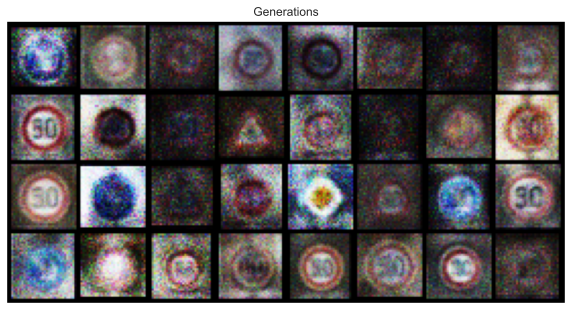

Epoch: 141, discriminator fake error: 0.311, discriminator real acc: 0.687
Epoch: 142, discriminator fake error: 0.311, discriminator real acc: 0.694
Epoch: 143, discriminator fake error: 0.31, discriminator real acc: 0.693
Epoch: 144, discriminator fake error: 0.316, discriminator real acc: 0.683
Epoch: 145, discriminator fake error: 0.314, discriminator real acc: 0.687
Epoch: 146, discriminator fake error: 0.319, discriminator real acc: 0.68
Epoch: 147, discriminator fake error: 0.315, discriminator real acc: 0.686
Epoch: 148, discriminator fake error: 0.316, discriminator real acc: 0.691
Epoch: 149, discriminator fake error: 0.306, discriminator real acc: 0.696
Epoch: 150, discriminator fake error: 0.313, discriminator real acc: 0.686


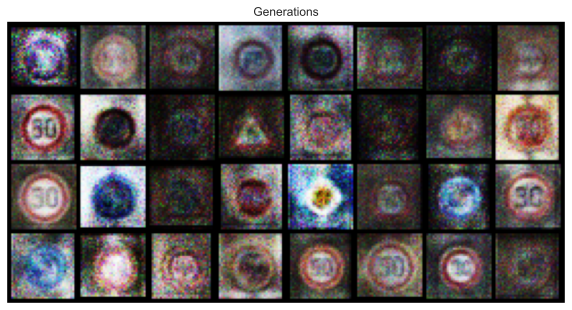

Epoch: 151, discriminator fake error: 0.319, discriminator real acc: 0.678
Epoch: 152, discriminator fake error: 0.32, discriminator real acc: 0.682
Epoch: 153, discriminator fake error: 0.325, discriminator real acc: 0.682
Epoch: 154, discriminator fake error: 0.319, discriminator real acc: 0.679
Epoch: 155, discriminator fake error: 0.322, discriminator real acc: 0.679
Epoch: 156, discriminator fake error: 0.315, discriminator real acc: 0.687
Epoch: 157, discriminator fake error: 0.303, discriminator real acc: 0.692
Epoch: 158, discriminator fake error: 0.314, discriminator real acc: 0.699
Epoch: 159, discriminator fake error: 0.315, discriminator real acc: 0.683
Epoch: 160, discriminator fake error: 0.311, discriminator real acc: 0.685


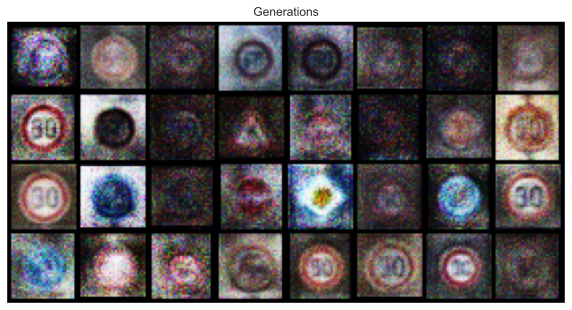

Epoch: 161, discriminator fake error: 0.322, discriminator real acc: 0.69
Epoch: 162, discriminator fake error: 0.314, discriminator real acc: 0.681
Epoch: 163, discriminator fake error: 0.317, discriminator real acc: 0.693
Epoch: 164, discriminator fake error: 0.32, discriminator real acc: 0.683
Epoch: 165, discriminator fake error: 0.315, discriminator real acc: 0.685
Epoch: 166, discriminator fake error: 0.316, discriminator real acc: 0.688
Epoch: 167, discriminator fake error: 0.31, discriminator real acc: 0.691
Epoch: 168, discriminator fake error: 0.309, discriminator real acc: 0.695
Epoch: 169, discriminator fake error: 0.309, discriminator real acc: 0.694
Epoch: 170, discriminator fake error: 0.305, discriminator real acc: 0.692


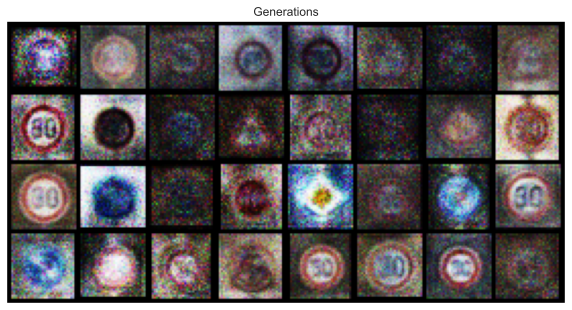

Epoch: 171, discriminator fake error: 0.314, discriminator real acc: 0.695
Epoch: 172, discriminator fake error: 0.31, discriminator real acc: 0.678
Epoch: 173, discriminator fake error: 0.317, discriminator real acc: 0.691
Epoch: 174, discriminator fake error: 0.317, discriminator real acc: 0.682
Epoch: 175, discriminator fake error: 0.315, discriminator real acc: 0.684
Epoch: 176, discriminator fake error: 0.315, discriminator real acc: 0.694
Epoch: 177, discriminator fake error: 0.301, discriminator real acc: 0.688
Epoch: 178, discriminator fake error: 0.309, discriminator real acc: 0.706
Epoch: 179, discriminator fake error: 0.305, discriminator real acc: 0.689
Epoch: 180, discriminator fake error: 0.31, discriminator real acc: 0.696


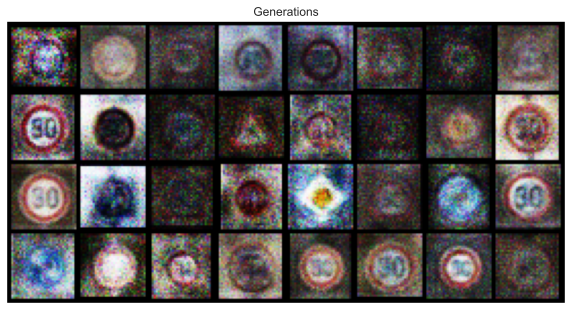

Epoch: 181, discriminator fake error: 0.305, discriminator real acc: 0.696
Epoch: 182, discriminator fake error: 0.307, discriminator real acc: 0.694
Epoch: 183, discriminator fake error: 0.3, discriminator real acc: 0.7
Epoch: 184, discriminator fake error: 0.295, discriminator real acc: 0.708
Epoch: 185, discriminator fake error: 0.299, discriminator real acc: 0.704
Epoch: 186, discriminator fake error: 0.291, discriminator real acc: 0.704
Epoch: 187, discriminator fake error: 0.303, discriminator real acc: 0.706
Epoch: 188, discriminator fake error: 0.291, discriminator real acc: 0.704
Epoch: 189, discriminator fake error: 0.305, discriminator real acc: 0.703
Epoch: 190, discriminator fake error: 0.311, discriminator real acc: 0.685


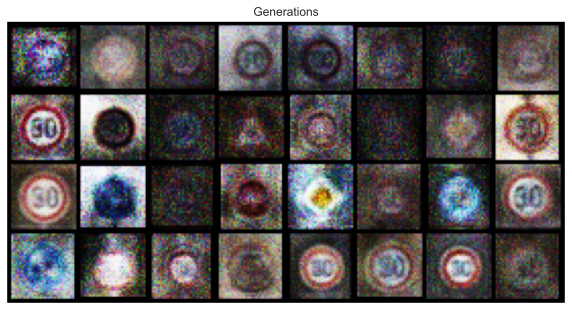

Epoch: 191, discriminator fake error: 0.308, discriminator real acc: 0.7
Epoch: 192, discriminator fake error: 0.311, discriminator real acc: 0.693
Epoch: 193, discriminator fake error: 0.301, discriminator real acc: 0.694
Epoch: 194, discriminator fake error: 0.311, discriminator real acc: 0.696
Epoch: 195, discriminator fake error: 0.303, discriminator real acc: 0.695
Epoch: 196, discriminator fake error: 0.308, discriminator real acc: 0.699
Epoch: 197, discriminator fake error: 0.301, discriminator real acc: 0.702
Epoch: 198, discriminator fake error: 0.301, discriminator real acc: 0.701
Epoch: 199, discriminator fake error: 0.297, discriminator real acc: 0.709
Epoch: 200, discriminator fake error: 0.291, discriminator real acc: 0.708


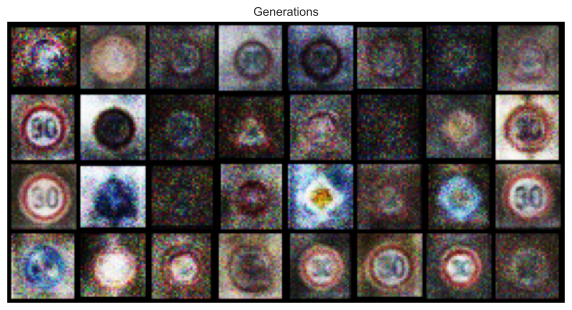

Epoch: 201, discriminator fake error: 0.291, discriminator real acc: 0.714
Epoch: 202, discriminator fake error: 0.29, discriminator real acc: 0.706
Epoch: 203, discriminator fake error: 0.294, discriminator real acc: 0.708
Epoch: 204, discriminator fake error: 0.284, discriminator real acc: 0.72
Epoch: 205, discriminator fake error: 0.293, discriminator real acc: 0.705
Epoch: 206, discriminator fake error: 0.293, discriminator real acc: 0.714
Epoch: 207, discriminator fake error: 0.286, discriminator real acc: 0.71
Epoch: 208, discriminator fake error: 0.29, discriminator real acc: 0.715
Epoch: 209, discriminator fake error: 0.284, discriminator real acc: 0.714
Epoch: 210, discriminator fake error: 0.294, discriminator real acc: 0.714


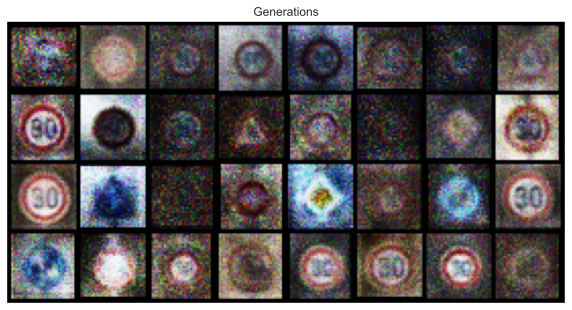

Epoch: 211, discriminator fake error: 0.29, discriminator real acc: 0.707
Epoch: 212, discriminator fake error: 0.291, discriminator real acc: 0.715
Epoch: 213, discriminator fake error: 0.291, discriminator real acc: 0.71
Epoch: 214, discriminator fake error: 0.297, discriminator real acc: 0.708
Epoch: 215, discriminator fake error: 0.298, discriminator real acc: 0.705
Epoch: 216, discriminator fake error: 0.295, discriminator real acc: 0.705
Epoch: 217, discriminator fake error: 0.294, discriminator real acc: 0.711
Epoch: 218, discriminator fake error: 0.288, discriminator real acc: 0.711
Epoch: 219, discriminator fake error: 0.296, discriminator real acc: 0.709
Epoch: 220, discriminator fake error: 0.293, discriminator real acc: 0.704


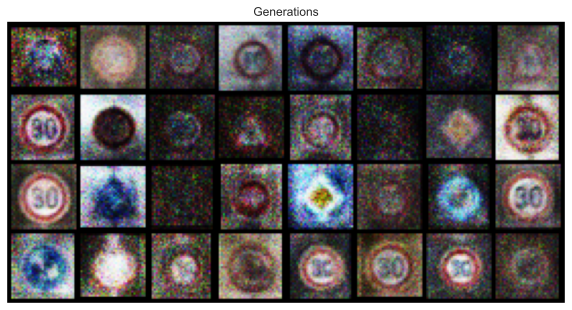

Epoch: 221, discriminator fake error: 0.304, discriminator real acc: 0.701
Epoch: 222, discriminator fake error: 0.3, discriminator real acc: 0.7
Epoch: 223, discriminator fake error: 0.302, discriminator real acc: 0.701
Epoch: 224, discriminator fake error: 0.298, discriminator real acc: 0.703
Epoch: 225, discriminator fake error: 0.297, discriminator real acc: 0.705
Epoch: 226, discriminator fake error: 0.305, discriminator real acc: 0.695
Epoch: 227, discriminator fake error: 0.301, discriminator real acc: 0.7
Epoch: 228, discriminator fake error: 0.3, discriminator real acc: 0.704
Epoch: 229, discriminator fake error: 0.297, discriminator real acc: 0.702
Epoch: 230, discriminator fake error: 0.301, discriminator real acc: 0.701


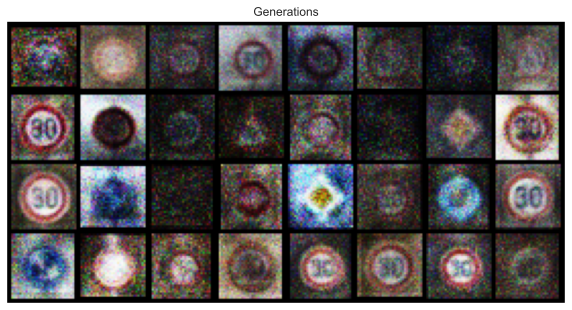

Epoch: 231, discriminator fake error: 0.301, discriminator real acc: 0.697
Epoch: 232, discriminator fake error: 0.3, discriminator real acc: 0.702
Epoch: 233, discriminator fake error: 0.3, discriminator real acc: 0.699
Epoch: 234, discriminator fake error: 0.304, discriminator real acc: 0.695
Epoch: 235, discriminator fake error: 0.306, discriminator real acc: 0.696
Epoch: 236, discriminator fake error: 0.303, discriminator real acc: 0.698
Epoch: 237, discriminator fake error: 0.304, discriminator real acc: 0.697
Epoch: 238, discriminator fake error: 0.306, discriminator real acc: 0.693
Epoch: 239, discriminator fake error: 0.307, discriminator real acc: 0.694
Epoch: 240, discriminator fake error: 0.305, discriminator real acc: 0.695


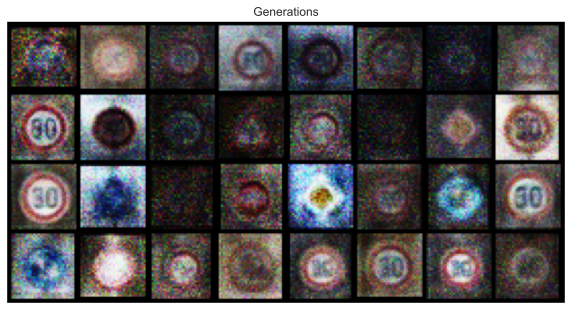

Epoch: 241, discriminator fake error: 0.3, discriminator real acc: 0.699
Epoch: 242, discriminator fake error: 0.299, discriminator real acc: 0.703
Epoch: 243, discriminator fake error: 0.304, discriminator real acc: 0.695
Epoch: 244, discriminator fake error: 0.307, discriminator real acc: 0.691
Epoch: 245, discriminator fake error: 0.301, discriminator real acc: 0.697
Epoch: 246, discriminator fake error: 0.299, discriminator real acc: 0.7
Epoch: 247, discriminator fake error: 0.301, discriminator real acc: 0.7
Epoch: 248, discriminator fake error: 0.302, discriminator real acc: 0.697
Epoch: 249, discriminator fake error: 0.3, discriminator real acc: 0.7
Epoch: 250, discriminator fake error: 0.292, discriminator real acc: 0.707


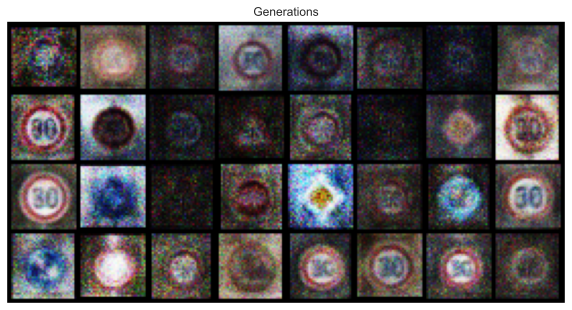

Epoch: 251, discriminator fake error: 0.302, discriminator real acc: 0.699
Epoch: 252, discriminator fake error: 0.306, discriminator real acc: 0.693
Epoch: 253, discriminator fake error: 0.31, discriminator real acc: 0.691
Epoch: 254, discriminator fake error: 0.305, discriminator real acc: 0.694
Epoch: 255, discriminator fake error: 0.301, discriminator real acc: 0.7
Epoch: 256, discriminator fake error: 0.303, discriminator real acc: 0.696
Epoch: 257, discriminator fake error: 0.304, discriminator real acc: 0.696
Epoch: 258, discriminator fake error: 0.298, discriminator real acc: 0.704
Epoch: 259, discriminator fake error: 0.296, discriminator real acc: 0.703
Epoch: 260, discriminator fake error: 0.299, discriminator real acc: 0.703


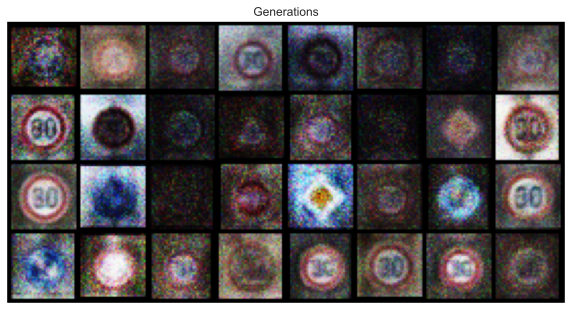

Epoch: 261, discriminator fake error: 0.304, discriminator real acc: 0.696
Epoch: 262, discriminator fake error: 0.305, discriminator real acc: 0.697
Epoch: 263, discriminator fake error: 0.306, discriminator real acc: 0.696
Epoch: 264, discriminator fake error: 0.302, discriminator real acc: 0.699
Epoch: 265, discriminator fake error: 0.304, discriminator real acc: 0.698
Epoch: 266, discriminator fake error: 0.303, discriminator real acc: 0.698
Epoch: 267, discriminator fake error: 0.301, discriminator real acc: 0.7
Epoch: 268, discriminator fake error: 0.298, discriminator real acc: 0.701
Epoch: 269, discriminator fake error: 0.299, discriminator real acc: 0.7
Epoch: 270, discriminator fake error: 0.3, discriminator real acc: 0.697


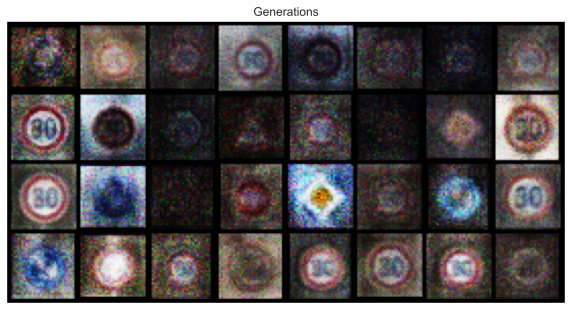

Epoch: 271, discriminator fake error: 0.306, discriminator real acc: 0.694
Epoch: 272, discriminator fake error: 0.302, discriminator real acc: 0.695
Epoch: 273, discriminator fake error: 0.305, discriminator real acc: 0.695
Epoch: 274, discriminator fake error: 0.307, discriminator real acc: 0.693
Epoch: 275, discriminator fake error: 0.308, discriminator real acc: 0.69
Epoch: 276, discriminator fake error: 0.304, discriminator real acc: 0.696
Epoch: 277, discriminator fake error: 0.299, discriminator real acc: 0.7
Epoch: 278, discriminator fake error: 0.302, discriminator real acc: 0.698
Epoch: 279, discriminator fake error: 0.301, discriminator real acc: 0.697
Epoch: 280, discriminator fake error: 0.303, discriminator real acc: 0.697


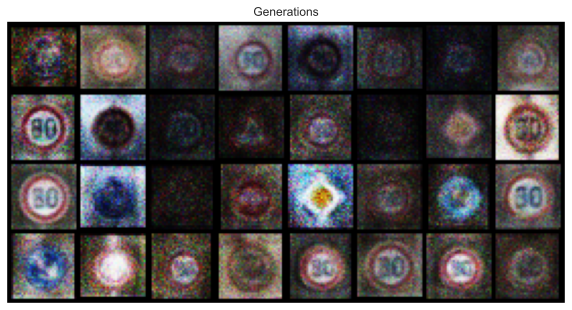

Epoch: 281, discriminator fake error: 0.304, discriminator real acc: 0.697
Epoch: 282, discriminator fake error: 0.303, discriminator real acc: 0.696
Epoch: 283, discriminator fake error: 0.303, discriminator real acc: 0.696
Epoch: 284, discriminator fake error: 0.303, discriminator real acc: 0.695
Epoch: 285, discriminator fake error: 0.306, discriminator real acc: 0.694
Epoch: 286, discriminator fake error: 0.301, discriminator real acc: 0.697
Epoch: 287, discriminator fake error: 0.296, discriminator real acc: 0.705
Epoch: 288, discriminator fake error: 0.291, discriminator real acc: 0.708
Epoch: 289, discriminator fake error: 0.291, discriminator real acc: 0.71
Epoch: 290, discriminator fake error: 0.296, discriminator real acc: 0.704


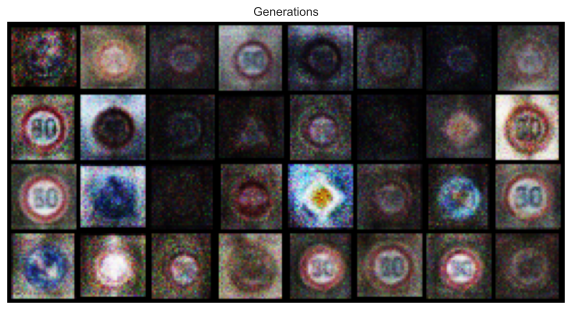

Epoch: 291, discriminator fake error: 0.302, discriminator real acc: 0.697
Epoch: 292, discriminator fake error: 0.305, discriminator real acc: 0.696
Epoch: 293, discriminator fake error: 0.303, discriminator real acc: 0.698
Epoch: 294, discriminator fake error: 0.301, discriminator real acc: 0.699
Epoch: 295, discriminator fake error: 0.301, discriminator real acc: 0.697
Epoch: 296, discriminator fake error: 0.302, discriminator real acc: 0.698
Epoch: 297, discriminator fake error: 0.301, discriminator real acc: 0.699
Epoch: 298, discriminator fake error: 0.296, discriminator real acc: 0.703
Epoch: 299, discriminator fake error: 0.293, discriminator real acc: 0.706


In [18]:
G_losses = []
D_losses = []
num_epochs = 300
for epoch in range(num_epochs):
    # For each batch in the dataloader
    discriminator_fake_acc = []
    discriminator_real_acc = []
    for i, data in enumerate(trainloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        discriminator_optimizer.zero_grad()
        # Format batch
        real_images = data[0].to(device)
        b_size = real_images.size(0)
        label = torch.ones((b_size,), dtype=torch.float, device=device) # Setting labels for real images
        # Forward pass real batch through D
        output = discriminator(real_images).view(-1)
        # Calculate loss on all-real batch
        error_discriminator_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        discriminator_real_acc.append(output.mean().item())

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, latent_dim,device=device)
        # Generate fake image batch with Generator
        fake_images = generator(noise)
        label_fake = torch.zeros((b_size,), dtype=torch.float, device=device)
        # Classify all fake batch with Discriminator
        output = discriminator(fake_images.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        error_discriminator_fake = criterion(output, label_fake)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        discriminator_fake_acc.append(output.mean().item())
        # Compute error of D as sum over the fake and the real batches
        error_discriminator = error_discriminator_real + error_discriminator_fake
        error_discriminator.backward()
        # Update D
        discriminator_optimizer.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        generator_optimizer.zero_grad()
        label = torch.ones((b_size,), dtype=torch.float, device=device)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = discriminator(fake_images).view(-1)
        # Calculate G's loss based on this output
        error_generator = criterion(output, label)
        # Calculate gradients for G
        error_generator.backward()
        D_G_z2 = output.mean().item()
        # Update G
        generator_optimizer.step()

        # Output training stats
        # Save Losses for plotting later
        G_losses.append(error_generator.item())
        D_losses.append(error_discriminator.item())

    print(f"Epoch: {epoch}, discriminator fake error: {np.mean(discriminator_fake_acc):.3}, discriminator real acc: {np.mean(discriminator_real_acc):.3}")
    generator_scheduler.step()
    discriminator_scheduler.step()
    if epoch % 10 == 0:
        with torch.no_grad():
            fake = generator(fixed_noise).detach().cpu()
            
        grid = torchvision.utils.make_grid(fake)
        grid = grid.permute(1, 2, 0)
        plt.figure(figsize=(10,10))
        plt.title(f"Generations")
        plt.imshow(grid)
        plt.axis('off')
        plt.show()

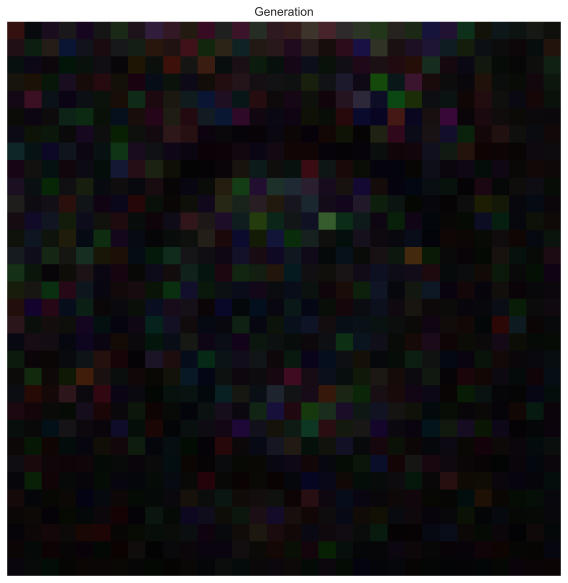

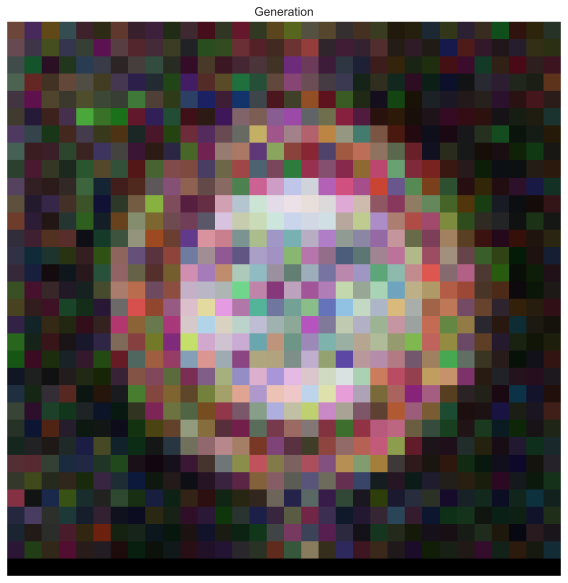

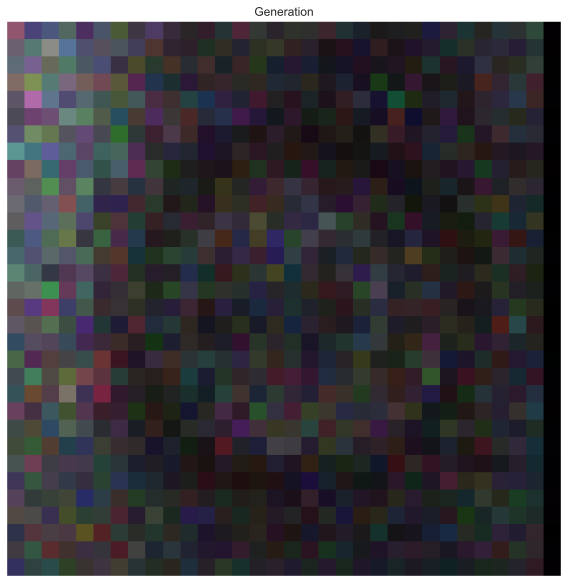

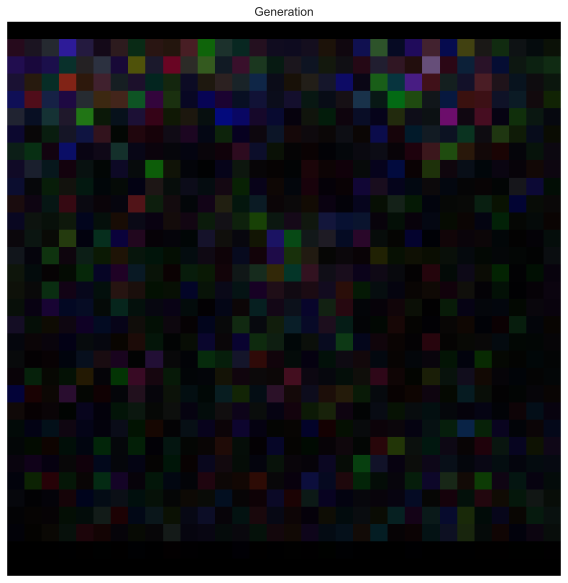

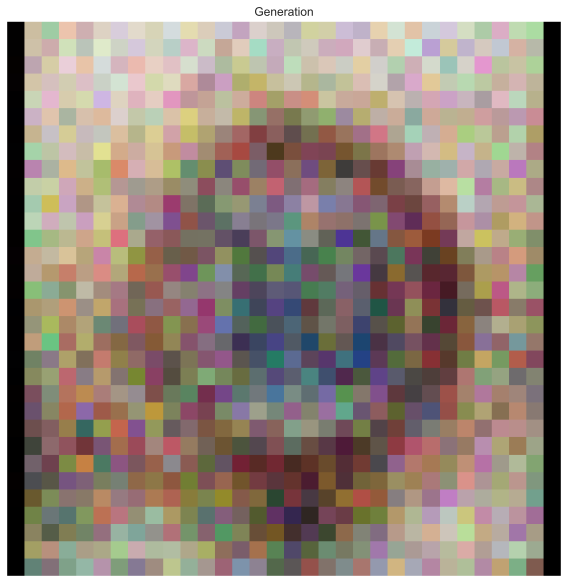

...

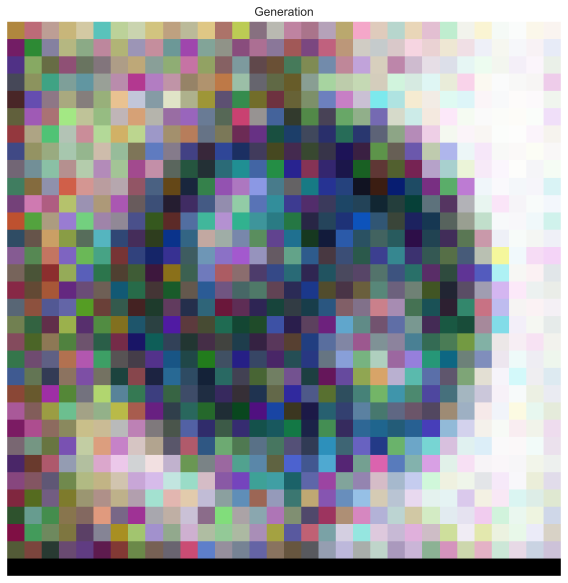

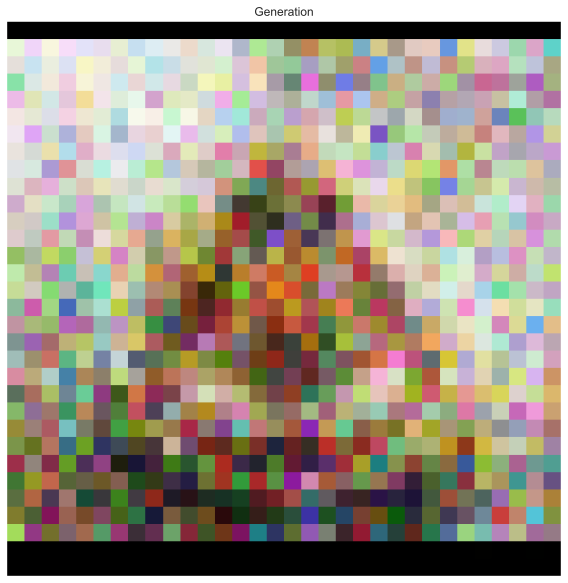

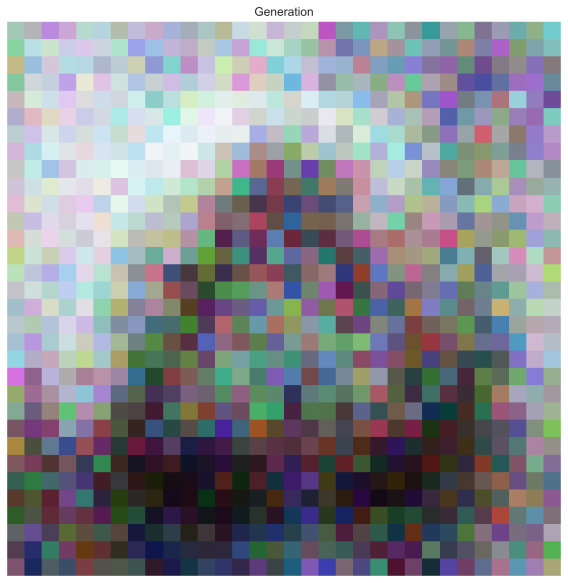

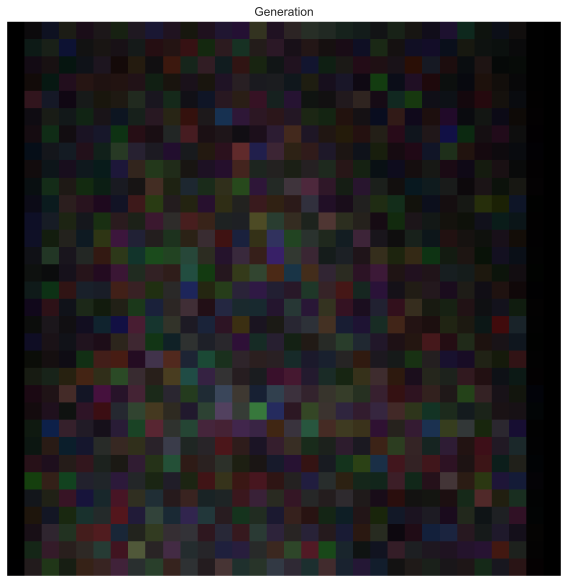

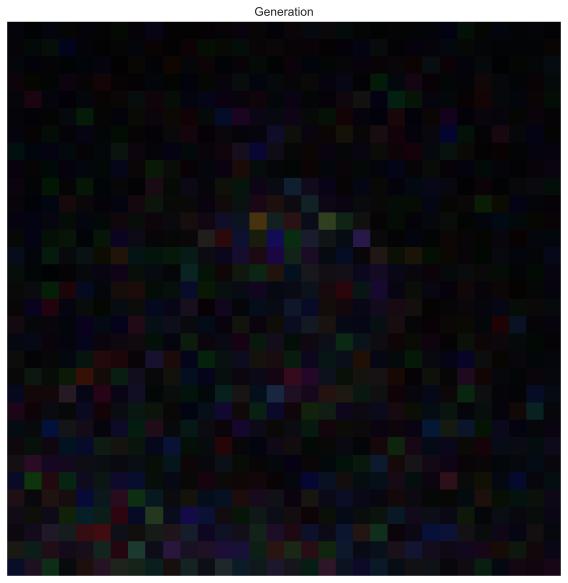

In [19]:
generator.eval()
num_images = 1000
generated_images = []

with torch.no_grad():
    for i in range(num_images):
        noise = torch.randn(1, latent_dim, device=device)
        generated_image = generator(noise)
        generated_images.append(generated_image)

        if i % 10 == 0:
            plt.figure(figsize=(10,10))
            plt.title(f"Generation")
            plt.imshow(generated_image.squeeze().permute(1, 2, 0).cpu())
            plt.axis('off')
            plt.show()

generated_images = torch.cat(generated_images, dim=0)
generated_images = generated_images.view(num_images, 3, 32, 32)

torch.save(generated_images.cpu().detach(),"poniedzialek_grunwald_rozkosz.pt")

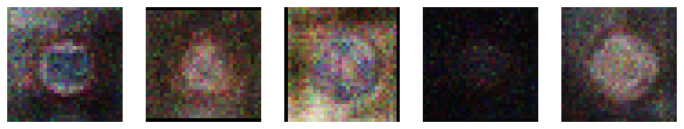

In [32]:
generated_images = torch.load("poniedzialek_grunwald_rozkosz.pt")

# Wyświetl kilka losowych obrazów z pliku
num_images_to_display = 5
random_indices = torch.randint(0, generated_images.size(0), (num_images_to_display,))

fig, axes = plt.subplots(1, num_images_to_display, figsize=(12, 4))

for i, ax in enumerate(axes):
    image = generated_images[random_indices[i]].permute(1, 2, 0)
    ax.imshow(image)
    ax.axis("off")

plt.show()